# Soybean Disease Leaf Classification
zbiór danych: https://www.kaggle.com/datasets/sivm205/soybean-diseased-leaf-dataset


## Analiza obrazów
* wczytanie obrazów (czy kolor czy rgb czy np. tylko jeden channel)
* analiza obrazu
* ewentualny resize
* augumentacja w razie potrzeby
* blur w razie potrzeby
* obliczyc histogram, zobaczyc czy nie trzeba podnieść kontrastu, zrównać histogramów wszystkich obrazów etc
* wyciagnac cechy na kilka sposobów (Histogram, histogram HOG, PCA, TSNE, GLCM, GLRLM, LBP, Canny) - i pewnie wiele innych odsylam Państwa do literatury.

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg


def get_images_from_folder(folder_path):
    image_list = []
    for root, dirs, files in os.walk(folder_path):
        for file in files:
            if file.lower().endswith(('.png', '.jpg', '.jpeg', '.gif', '.bmp')):
                path  = os.path.join(root, file)
                image_list.append(cv2.imread(path))
    return image_list

def organize_images_by_folder(folder_path):
    image_map = {}
    for root, dirs, files in os.walk(folder_path):
        if files:
            folder_name = os.path.basename(root)
            images_in_folder = get_images_from_folder(root)
            image_map[folder_name] = images_in_folder
    return image_map

def save_images(image_map, output_folder_name):
    for disease, images in image_map.items():
        output_folder = os.path.join(output_folder_name, disease)
    
        if not os.path.exists(output_folder):
            os.makedirs(output_folder)
        
        for i, image in enumerate(images):
            _, filename = os.path.split(image)
            output_path = os.path.join(output_folder, filename)
    
        cv2.imwrite(output_path, image)

def display_images(image_map, rows, cols):
    fig, axs = plt.subplots(rows, cols, figsize=(12, 12))

    for i, (title, images) in enumerate(image_map.items()):
        for j, img in enumerate(images[:cols]):
            axs[i, j].imshow(cv2.cvtColor(img, cv2.COLOR_BGR2RGB))  # Konwersja kolorów BGR na RGB
            axs[i, j].axis("off")
            axs[i, j].set_title(title)
    plt.show()

folder_path = "./images" 
image_map = organize_images_by_folder(folder_path)

display_images(image_map, 3, 3)

Obrazy zostały wczytane do mapy postaci :
Nazwa_choroby : List<Obrazow>

In [9]:
from rembg import remove

removed_background_images = {}
for disease, images in image_map.items():
    removed_background_images[disease] = [remove(image) for image in images]
    
print(removed_background_images)

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.
100%|████████████████████████████████████████| 176M/176M [00:00<00:00, 451GB/s]


KeyboardInterrupt: 

In [4]:
### make background black

import os
import cv2
from rembg import remove

folder_path = './images/Yellow_mosaic'
op_path = folder_path

file_list = os.listdir(folder_path)

image_extensions = ['.jpg', '.jpeg', '.png', '.bmp']
image_files = [file for file in file_list if any(file.lower().endswith(ext) for ext in image_extensions)]


i = 0
for image_file in image_files:
    
    image_path = os.path.join(folder_path, image_file)
    
    img = cv2.imread(image_path)
    output = remove(img)    
    save_path = os.path.join(op_path, f"{os.path.splitext(image_file)[0]}{i}_saved.jpg")
    cv2.imwrite(save_path, output)
    i= i+1


OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


FileNotFoundError: [Errno 2] No such file or directory: 'D:/mow2/Soybean_Disease_Leaf_Classification/images/Yellow_mosaic'

In [ ]:
import os
import cv2
import matplotlib.pyplot as plt

# Specify the path to the root folder containing subfolders for each class
root_folder = './nobgimages/'

# Get a list of all subfolders (each subfolder corresponds to a class)
class_folders = [folder for folder in os.listdir(root_folder) if os.path.isdir(os.path.join(root_folder, folder))]

# Display the list of classes
print("Classes:")
print(class_folders)

# Loop through each class folder and read/display images
for class_folder in class_folders:
    # Construct the full path to the class folder
    class_folder_path = os.path.join(root_folder, class_folder)
    
    # Get a list of all files in the class folder
    file_list = os.listdir(class_folder_path)
    
    # Filter only files with specific image extensions (e.g., jpg, jpeg, png)
    image_extensions = ['.jpg', '.jpeg', '.png']
    image_files = [file for file in file_list if any(file.lower().endswith(ext) for ext in image_extensions)]
    
    # Display the class name and the list of image files
    print(f"\nClass: {class_folder}")
    print("Image Files:")
    print(image_files)
    
    # Loop through each image file in the class folder and read/display it
    for image_file in image_files:
        # Construct the full path to the image file
        image_path = os.path.join(class_folder_path, image_file)
        
        # Read the image using OpenCV
        img = cv2.imread(image_path)
        
        # Convert BGR image to RGB (OpenCV uses BGR by default)
        img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
        
        # Display the image using matplotlib
        plt.imshow(img_rgb)
        plt.title(class_folder)  # Set the title to the class name
        plt.axis('off')
        plt.show()


### pre processing
#### patrząc na powyższe zdjęcia widzimy że trzeba wyciąć tło zdjęć by nie wplywało na model

In [33]:
### resize images

import os
import cv2
import matplotlib.pyplot as plt

directory = 'yellow_mosaic'

folder_path = '/Users/kacperskurski/DataspellProjects/Soybean_Disease_Leaf_Classification/nobgimages/' + directory

op_path = '/Users/kacperskurski/DataspellProjects/Soybean_Disease_Leaf_Classification/resized/' + directory

file_list = os.listdir(folder_path)

image_extensions = ['.jpg', '.jpeg', '.png', '.bmp']
image_files = [file for file in file_list if any(file.lower().endswith(ext) for ext in image_extensions)]

i = 0
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)
    img = cv2.imread(image_path)
    output = cv2.resize(img, (200, 200), interpolation=cv2.INTER_AREA)

    save_path = os.path.join(op_path, f"{os.path.splitext(image_file)[0]}{i}.jpg")
    cv2.imwrite(save_path, output)
    i= i+1


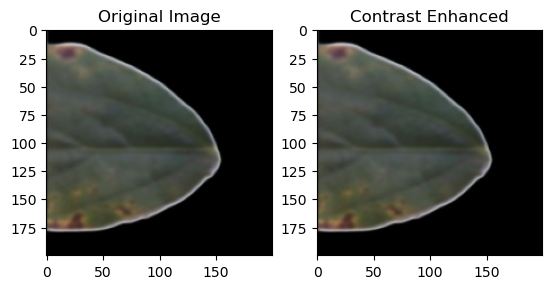

In [47]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def increase_contrast(image, alpha=-1.5, beta= 5):
    # Apply contrast stretching
    result = cv2.convertScaleAbs(image, alpha=alpha, beta=beta)

    return result

def decrease_contrast(image, gamma=1):
    # Apply gamma correction to decrease contrast
    result = np.power(image / 255.0, gamma) * 255.0
    result = np.uint8(result)

    return result

# Read an image
image = cv2.imread('D:/mow2/Soybean_Disease_Leaf_Classification/resized/brown_spot/bs (1)0_saved61.jpg')

# Increase contrast slightly
contrast_image = decrease_contrast(image)

# Display the original and contrast-enhanced images
plt.subplot(121), plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)), plt.title('Original Image')
plt.subplot(122), plt.imshow(cv2.cvtColor(contrast_image, cv2.COLOR_BGR2RGB)), plt.title('Contrast Enhanced')
plt.show()



In [48]:
import cv2
import numpy as np

def calculate_contrast(image):
    # Convert the image to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Calculate the standard deviation of pixel intensities
    contrast = np.std(gray)

    return contrast

# Read an image
image = cv2.imread('D:/mow2/Soybean_Disease_Leaf_Classification/resized/brown_spot/bs (1)0_saved61.jpg')

# Calculate and print the contrast of the image
image_contrast = calculate_contrast(image)
print(f"Contrast of the image: {image_contrast}")

image_contrast = calculate_contrast(contrast_image)
print(f"Contrast of the image: {image_contrast}")


Contrast of the image: 42.09848669486232
Contrast of the image: 42.09848669486232


In [65]:
### increase contrast
import os
import cv2
import matplotlib.pyplot as plt

directory = 'yellow_mosaic'

folder_path = 'D:/mow2/Soybean_Disease_Leaf_Classification/resized/' + directory

op_path = 'D:/mow2/Soybean_Disease_Leaf_Classification/contrast/' + directory

file_list = os.listdir(folder_path)

image_extensions = ['.jpg', '.jpeg', '.png', '.bmp']
image_files = [file for file in file_list if any(file.lower().endswith(ext) for ext in image_extensions)]

i = 0
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)
    img = cv2.imread(image_path)
    img_contrast = calculate_contrast(img)
    print(img_contrast)
    if img_contrast < 44 and img_contrast > 30:
        img = increase_contrast(img, alpha = 1.5, beta = 5)
        
    if img_contrast > 60 and img_contrast < 70:
        img = decrease_contrast(img, gamma = 1.1)

    save_path = os.path.join(op_path, f"{os.path.splitext(image_file)[0]}{i}.jpg")
    cv2.imwrite(save_path, img)
    i= i+1


61.05048771442678
74.49072218215753
63.457863770925776
3.638824046309467
69.35208010346554
10.454392188931884
19.49732961144936
41.34226824631179
69.58172088197806
66.87612077296349
51.047596830305096
57.65070831308146
69.19594328642033
67.93186305427207
81.35760684164696
77.3189763900008
73.87623190478365
65.3212983906283
75.37337519681601
5.107134146466098
19.355434094266652
64.78432486006453
19.582953805542207
1.5887593398623974
71.77669200669793
39.4102787958849
56.938609454196374
21.180480171846906
82.988785017254
77.65082189049498
28.19601693979799
72.93276352809055
80.28897037058937
84.9157820887849
71.89321794710541
86.77891813666136
76.88276938134042
63.41408632896559
72.99133403301637
16.9830477417188
19.229196211425478
70.75188652244104
32.479962723491155
62.38512829508628
62.37106206565268


In [2]:
import cv2
import numpy as np

def rotate_image(image, angle):
    # Get the image center
    center = tuple(np.array(image.shape[1::-1]) / 2)
    
    # Define the rotation matrix
    rotation_matrix = cv2.getRotationMatrix2D(center, angle, 1.0)
    
    # Perform the rotation
    rotated_image = cv2.warpAffine(image, rotation_matrix, image.shape[1::-1], flags=cv2.INTER_LINEAR)
    
    return rotated_image


In [68]:
import cv2
import numpy as np

def horizontal_flip(image):
    # Flip the image horizontally
    flipped_image = cv2.flip(image, 1)
    return flipped_image


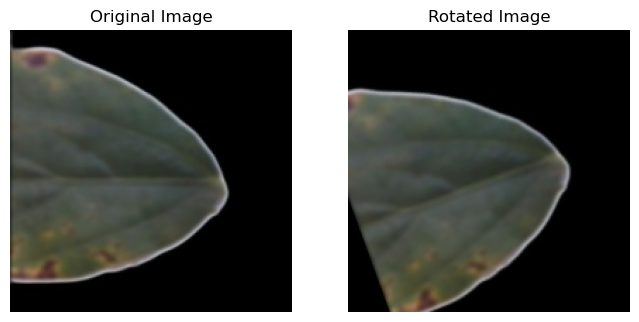

In [70]:
# Read an image
image = cv2.imread('D:/mow2/Soybean_Disease_Leaf_Classification/resized/brown_spot/bs (1)0_saved61.jpg')

# Apply rotation (e.g., rotate by 45 degrees)
rotated_image = rotate_image(image, 20)

# Display the original and rotated images using matplotlib
plt.figure(figsize=(8, 4))

plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(rotated_image, cv2.COLOR_BGR2RGB))
plt.title('Rotated Image')
plt.axis('off')

plt.show()


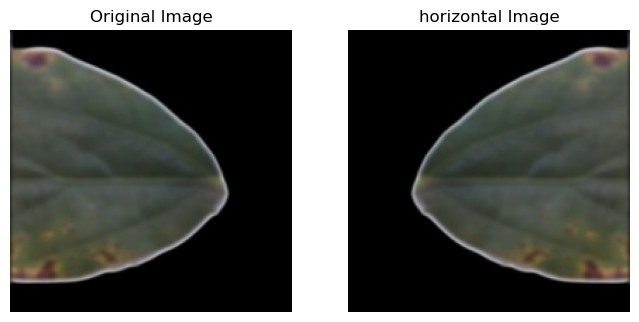

In [72]:
# Read an image
image = cv2.imread('D:/mow2/Soybean_Disease_Leaf_Classification/resized/brown_spot/bs (1)0_saved61.jpg')

# Apply rotation (e.g., rotate by 45 degrees)
rotated_image = horizontal_flip(image)

# Display the original and rotated images using matplotlib
plt.figure(figsize=(8, 4))

plt.subplot(1, 2, 1)
plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
plt.title('Original Image')
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(cv2.cvtColor(rotated_image, cv2.COLOR_BGR2RGB))
plt.title('horizontal Image')
plt.axis('off')

plt.show()

In [89]:
### horizontal
import os
import cv2
import matplotlib.pyplot as plt

directory = 'yellow_mosaic'

folder_path = 'D:/mow2/Soybean_Disease_Leaf_Classification/contrast/' + directory

op_path = 'D:/mow2/Soybean_Disease_Leaf_Classification/augumentation/' + directory

file_list = os.listdir(folder_path)

image_extensions = ['.jpg', '.jpeg', '.png', '.bmp']
image_files = [file for file in file_list if any(file.lower().endswith(ext) for ext in image_extensions)]

i = 0
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)
    original_file = cv2.imread(image_path)
    img = horizontal_flip(original_file)
    save_path = os.path.join(op_path, f"{os.path.splitext(image_file)[0]}{i}.jpg")
    cv2.imwrite(save_path, img)
    
    save_path = os.path.join(op_path, f"p{os.path.splitext(image_file)[0]}{i}.jpg")
    cv2.imwrite(save_path, original_file)
    i= i+1




In [1]:
### rotate
import os
import cv2
import matplotlib.pyplot as plt

directory = 'septoria'

folder_path = './Soybean_Disease_Leaf_Classification/contrast/' + directory

op_path = './Soybean_Disease_Leaf_Classification/augumentation/' + directory

file_list = os.listdir(folder_path)

image_extensions = ['.jpg', '.jpeg', '.png', '.bmp']
image_files = [file for file in file_list if any(file.lower().endswith(ext) for ext in image_extensions)]

i = 0
for image_file in image_files:
    angle = 20
    image_path = os.path.join(folder_path, image_file)
    original_file = cv2.imread(image_path)
    img = rotate_image(original_file, angle)
    save_path = os.path.join(op_path, f"r{angle}{os.path.splitext(image_file)[0]}{i}.jpg")
    cv2.imwrite(save_path, img)
    i= i+1



NameError: name 'rotate_image' is not defined

wyciagnac cechy na kilka sposobów (Histogram, histogram HOG, PCA, TSNE, GLCM, GLRLM, LBP, Canny)

In [22]:
import cv2
import matplotlib.pyplot as plt
from skimage.feature import hog
from skimage import exposure
from skimage.feature import graycomatrix, graycoprops
from skimage.feature import local_binary_pattern

def hog_feature(image):
    features, hog_image = hog(image, orientations=8, pixels_per_cell=(16, 16), cells_per_block=(1, 1), visualize=True, channel_axis= 3)
    hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))
    plt.imshow(hog_image_rescaled, cmap='gray')
    plt.title('HOG Feature')
    plt.show()

def glcm_feature(image):
    glcm = graycomatrix(image, [1], [0], symmetric=True, normed=True)
    plt.imshow(np.log1p(glcm[:, :, 0, 0]), cmap='gray')
    plt.title('GLCM Feature')
    
    plt.show()


def glrlm_feature(image):
    glcm = graycomatrix(image, [1], [0], symmetric=True, normed=True)

    # Oblicz właściwości GLRLM
    contrast = graycoprops(glcm, 'contrast')[0, 0]
    dissimilarity = graycoprops(glcm, 'dissimilarity')[0, 0]
    homogeneity = graycoprops(glcm, 'homogeneity')[0, 0]
    energy = graycoprops(glcm, 'energy')[0, 0]
    correlation = graycoprops(glcm, 'correlation')[0, 0]

    # Wyświetl obraz i wyniki GLRLM
    plt.imshow(image, cmap='gray')
    plt.title('Original Image')
    plt.show()

    print(f"Contrast: {contrast}")
    print(f"Dissimilarity: {dissimilarity}")
    print(f"Homogeneity: {homogeneity}")
    print(f"Energy: {energy}")
    print(f"Correlation: {correlation}")

def lbp_feature(image):
    lbp = local_binary_pattern(image, P=8, R=1, method='uniform')
    plt.imshow(lbp, cmap='gray')
    plt.title('LBP Feature')
    plt.show()

def color_and_saturation(image):
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    hue, saturation, value = cv2.split(hsv)

    plt.subplot(131), plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB)), plt.title('Original')
    plt.subplot(132), plt.imshow(hue, cmap='gray'), plt.title('Hue')
    plt.subplot(133), plt.imshow(saturation, cmap='gray'), plt.title('Saturation')
    plt.show()
### rotate
import os
import cv2
import matplotlib.pyplot as plt

def hog_feature(image):
    features, hog_image = hog(image, orientations=8, pixels_per_cell=(16, 16), cells_per_block=(1, 1), visualize=True, channel_axis= 1)
    hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))
    plt.imshow(hog_image_rescaled, cmap='gray')
    plt.title('HOG Feature')
    plt.show()
    return hog_image_rescaled

directory = 'septoria'

folder_path = '/Users/kacperskurski/DataspellProjects/Soybean_Disease_Leaf_Classification/augumentation/' + directory

op_path = '/Users/kacperskurski/DataspellProjects/Soybean_Disease_Leaf_Classification/feature_extraction/' + directory

file_list = os.listdir(folder_path)

image_extensions = ['.jpg', '.jpeg', '.png', '.bmp']
image_files = [file for file in file_list if any(file.lower().endswith(ext) for ext in image_extensions)]

i = 0
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)
    original_file = cv2.imread(image_path)
    img = cv2.cvtColor(original_file, cv2.COLOR_BGR2GRAY)
    print(img.shape)
    img = hog_feature(img)
    method = 'hog'
    save_path = os.path.join(op_path, f"{method}_{os.path.splitext(image_file)[0]}{i}.jpg")
    cv2.imwrite(save_path, img)
    i= i+1



(200, 200)


ValueError: Only images with two spatial dimensions are supported. If using with color/multichannel images, specify `channel_axis`.

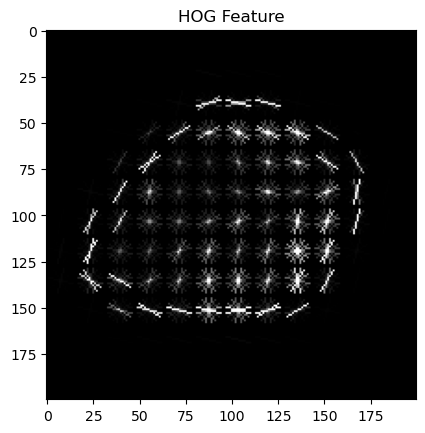

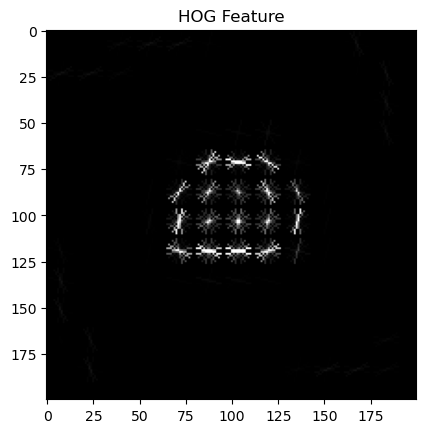

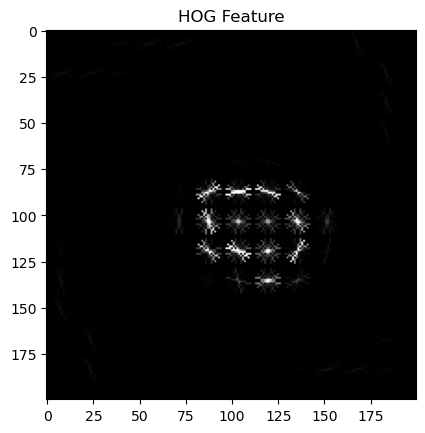

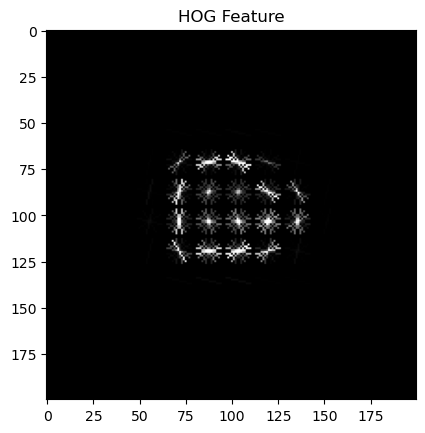

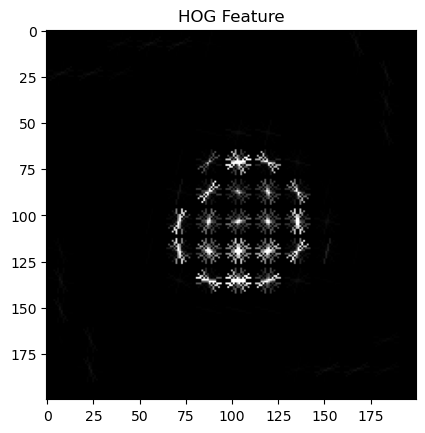

...

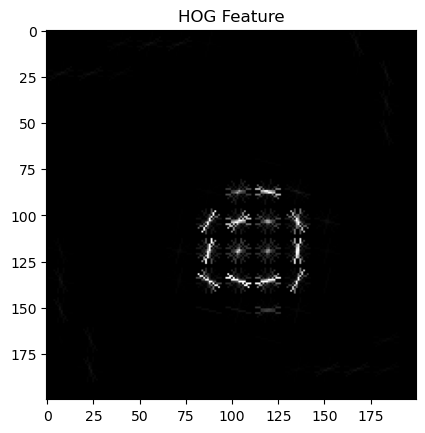

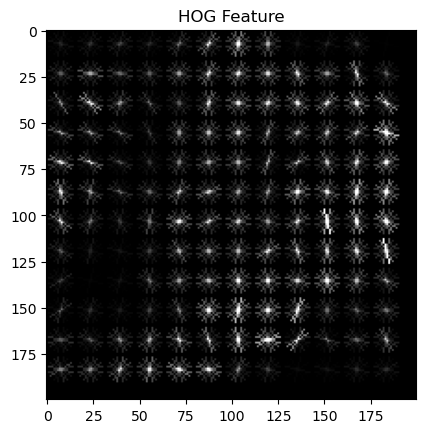

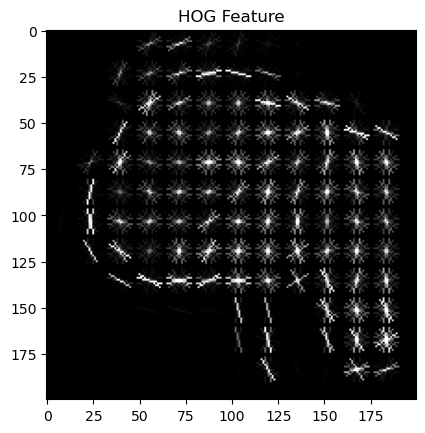

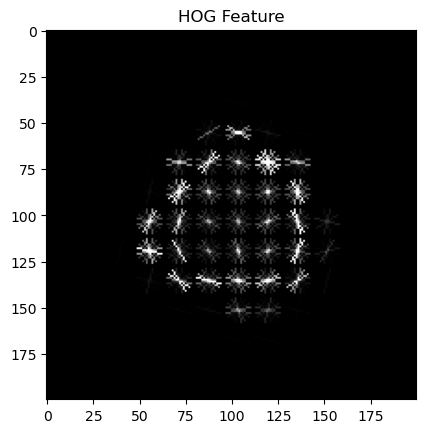

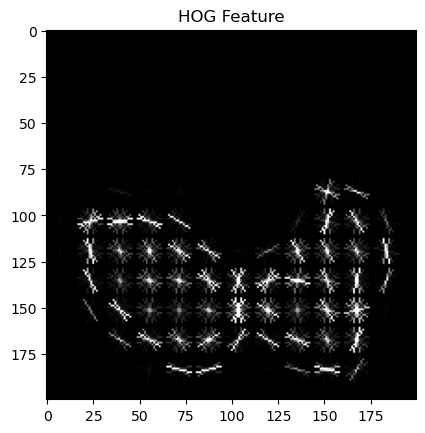

In [24]:
### rotate
import os
import cv2
import matplotlib.pyplot as plt

def hog_feature(image):
    features, hog_image = hog(image, orientations=8, pixels_per_cell=(16, 16), cells_per_block=(1, 1), visualize=True, channel_axis= 2)
    hog_image_rescaled = exposure.rescale_intensity(hog_image, in_range=(0, 10))
    plt.imshow(hog_image_rescaled, cmap='gray')
    plt.title('HOG Feature')
    plt.show()
    return hog_image_rescaled

directory = 'septoria'

folder_path = '/Users/kacperskurski/DataspellProjects/Soybean_Disease_Leaf_Classification/augumentation/' + directory

op_path = '/Users/kacperskurski/DataspellProjects/Soybean_Disease_Leaf_Classification/feature_extraction/' + directory

file_list = os.listdir(folder_path)

image_extensions = ['.jpg', '.jpeg', '.png', '.bmp']
image_files = [file for file in file_list if any(file.lower().endswith(ext) for ext in image_extensions)]

i = 0
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)
    original_file = cv2.imread(image_path)
    img = cv2.cvtColor(original_file, cv2.COLOR_BGR2GRAY)
    img = hog_feature(original_file)
    method = 'hog'
    save_path = os.path.join(op_path, f"{method}_{os.path.splitext(image_file)[0]}{i}.jpg")
    os.makedirs(save_path)
    cv2.imwrite(save_path, img)
    i= i+1

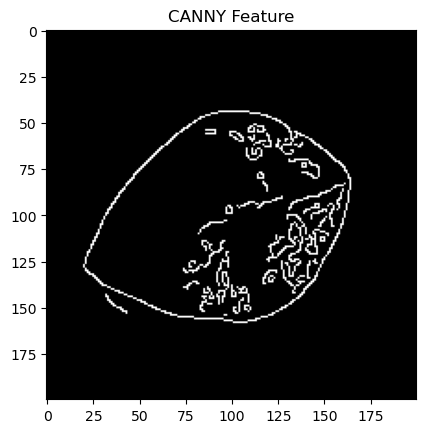

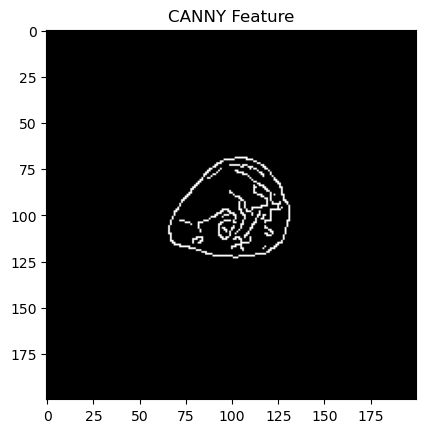

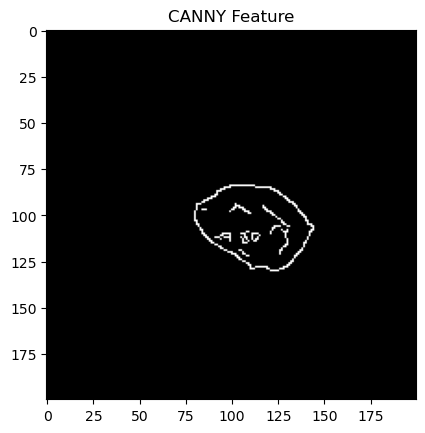

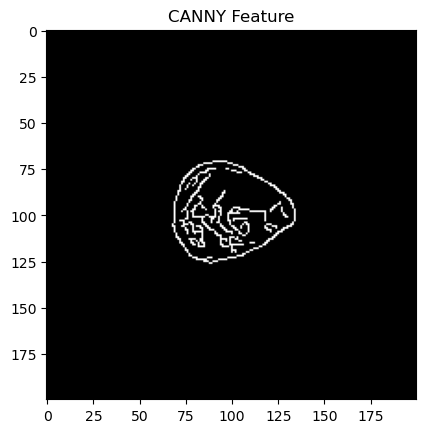

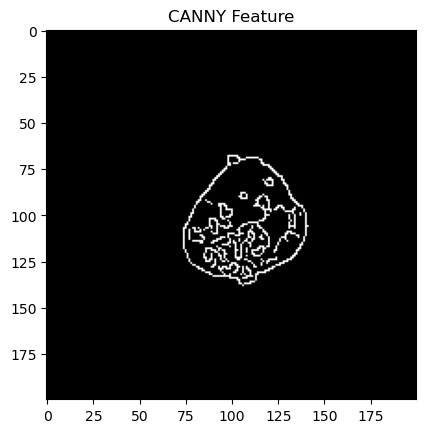

...

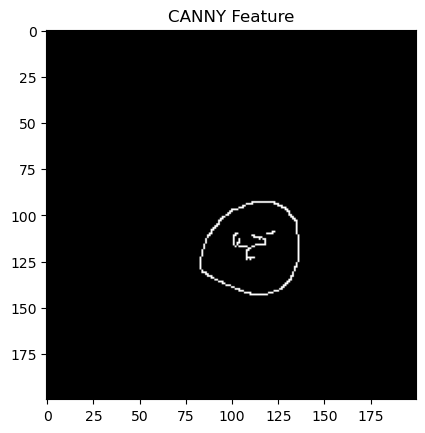

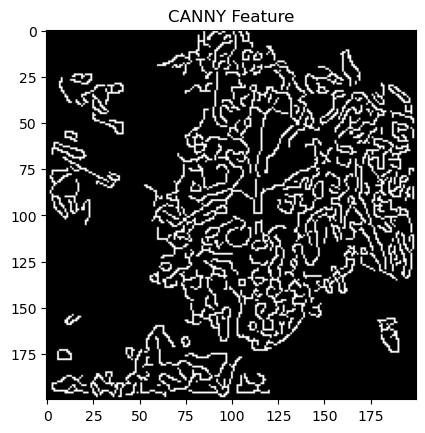

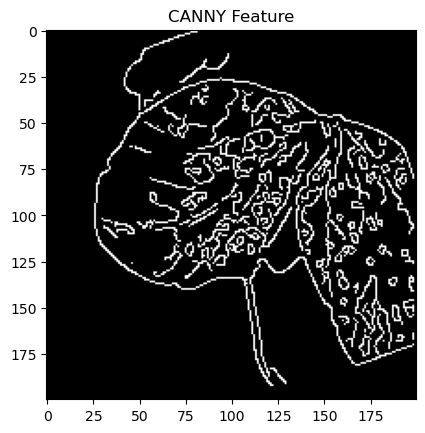

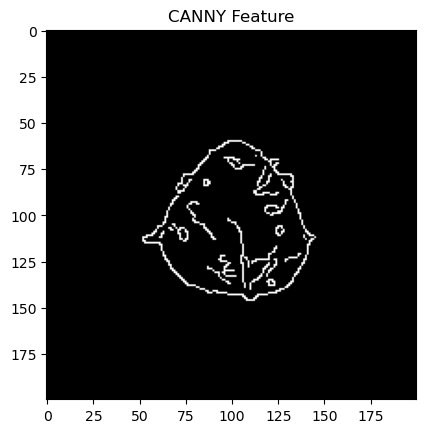

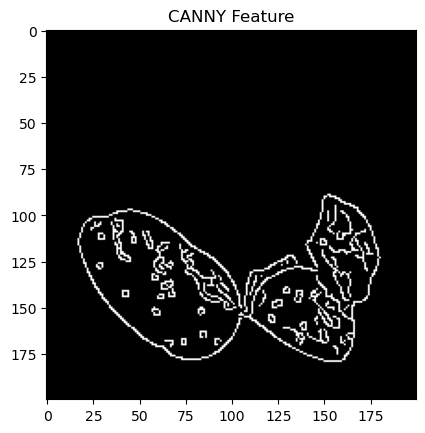

In [3]:
from skimage.exposure import rescale_intensity
import cv2
import matplotlib.pyplot as plt
from skimage.feature import hog
from skimage import exposure
from skimage.feature import graycomatrix, graycoprops
from skimage.feature import canny
import os

def canny_feature(image):
    canny_img = canny(image, sigma=1.0 )
    canny_img = canny_img.astype(np.uint8) * 255


    plt.imshow(canny_img, cmap='gray')
    plt.title('CANNY Feature')
    plt.show()
    return canny_img


directory = 'septoria'

folder_path = '/Users/kacperskurski/DataspellProjects/Soybean_Disease_Leaf_Classification/augumentation/' + directory

op_path = '/Users/kacperskurski/DataspellProjects/Soybean_Disease_Leaf_Classification/feature_extraction/' + directory

file_list = os.listdir(folder_path)

image_extensions = ['.jpg', '.jpeg', '.png', '.bmp']
image_files = [file for file in file_list if any(file.lower().endswith(ext) for ext in image_extensions)]

import numpy as np
i = 0
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)
    original_file = cv2.imread(image_path)
    img = cv2.cvtColor(original_file, cv2.COLOR_BGR2GRAY)

    img = canny_feature(img)
    method = 'canny'
    save_path = os.path.join(op_path, f"{method}_{os.path.splitext(image_file)[0]}{i}.jpg")
    if not os.path.exists(folder_path):
        os.makedirs(save_path)

    cv2.imwrite(save_path, img)
    i= i+1



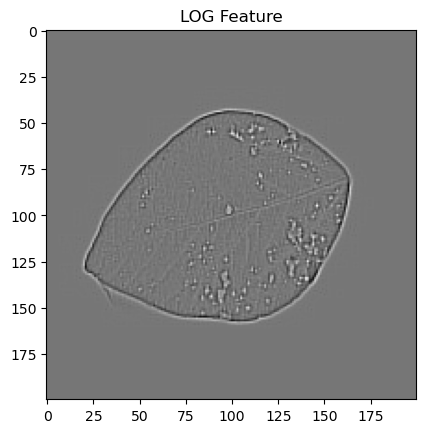

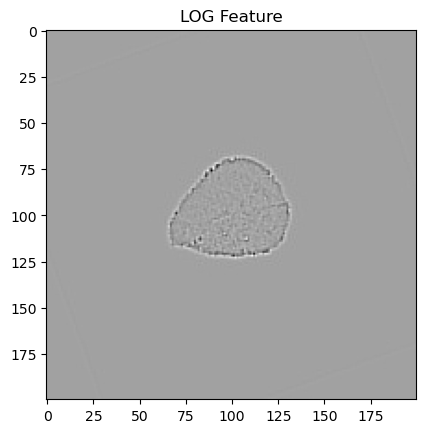

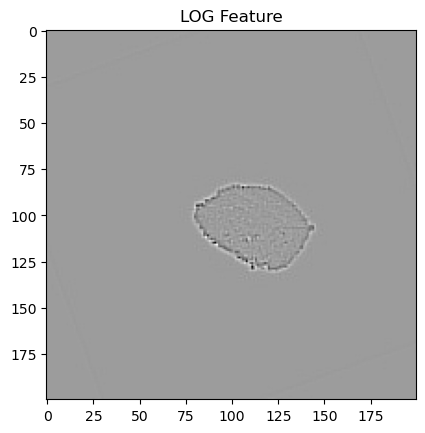

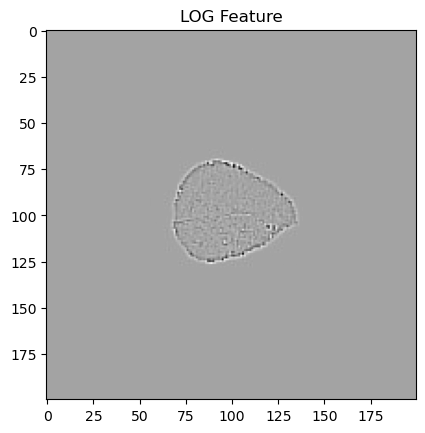

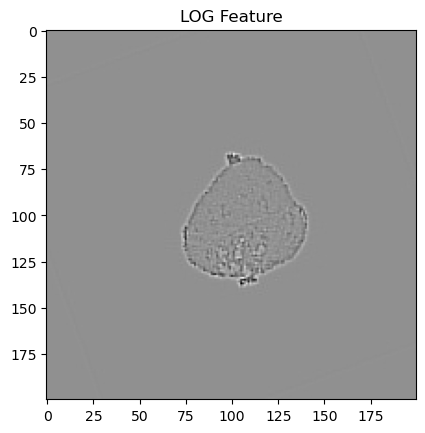

...

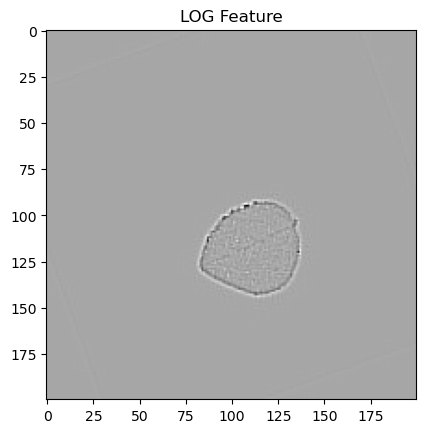

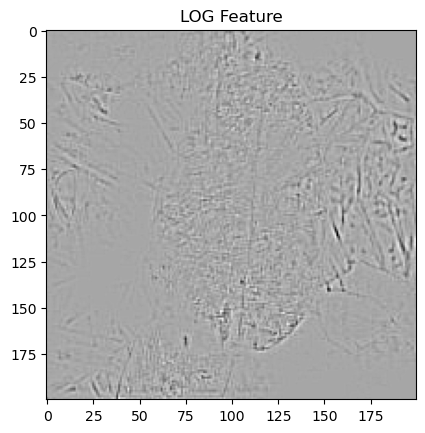

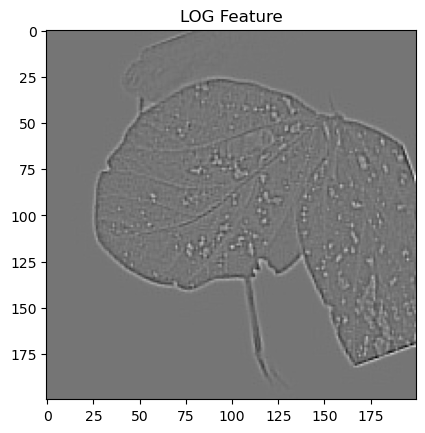

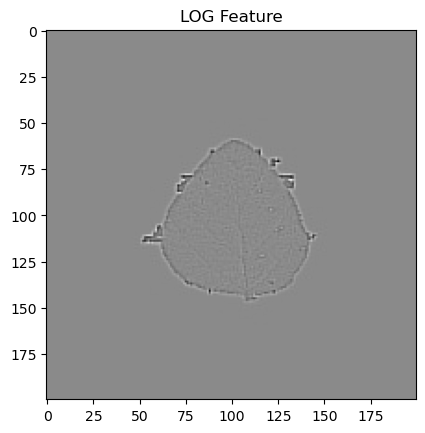

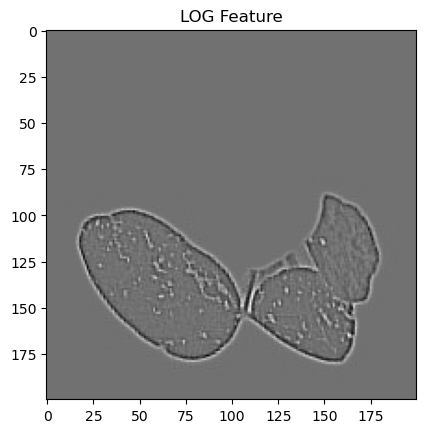

In [7]:
import os
from skimage import io, color
from skimage.feature import blob_doh
import cv2
import matplotlib.pyplot as plt

def log_feature(image):
    # Compute GLCM
    blob = cv2.Laplacian(image, cv2.CV_16S, ksize=3)

    plt.imshow(blob, cmap='gray')
    plt.title('LOG Feature')
    plt.show()

    return blob

directory = 'septoria'

folder_path = '/Users/kacperskurski/DataspellProjects/Soybean_Disease_Leaf_Classification/augumentation/' + directory

op_path = '/Users/kacperskurski/DataspellProjects/Soybean_Disease_Leaf_Classification/feature_extraction/' + directory

file_list = os.listdir(folder_path)

image_extensions = ['.jpg', '.jpeg', '.png', '.bmp']
image_files = [file for file in file_list if any(file.lower().endswith(ext) for ext in image_extensions)]

i = 0
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)
    original_file = cv2.imread(image_path)
    img = cv2.cvtColor(original_file, cv2.COLOR_BGR2GRAY)

    img = log_feature(img)
    method = 'log'
    save_path = os.path.join(op_path, f"{method}_{os.path.splitext(image_file)[0]}{i}.jpg")

    if not os.path.exists(folder_path):
        os.makedirs(save_path)

    cv2.imwrite(save_path, img)
    i= i+1



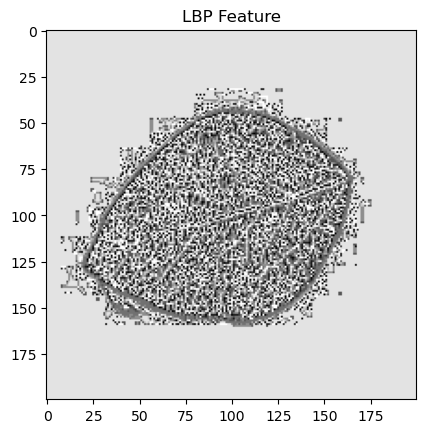

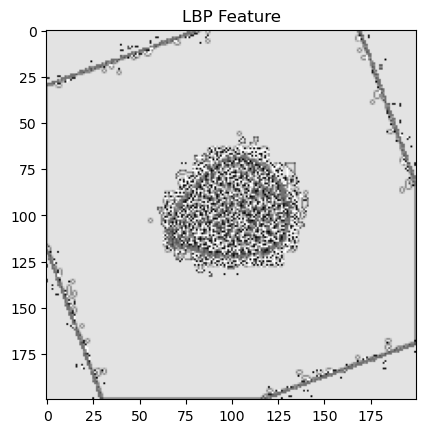

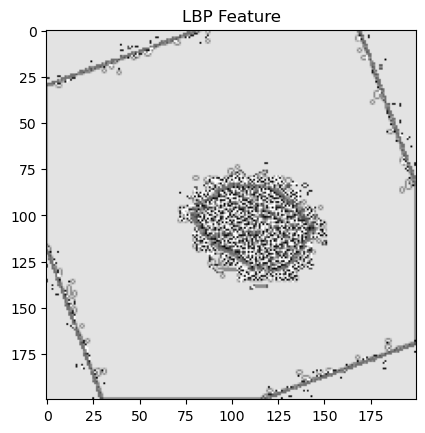

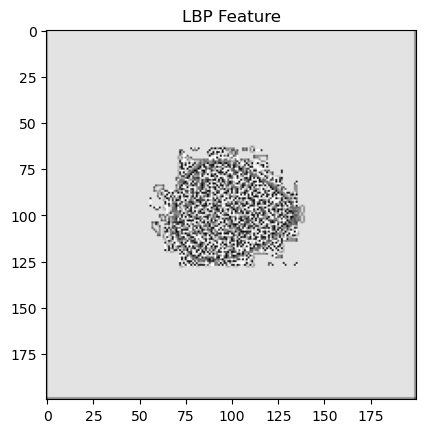

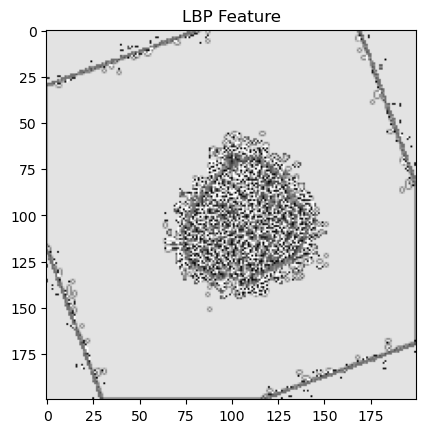

...

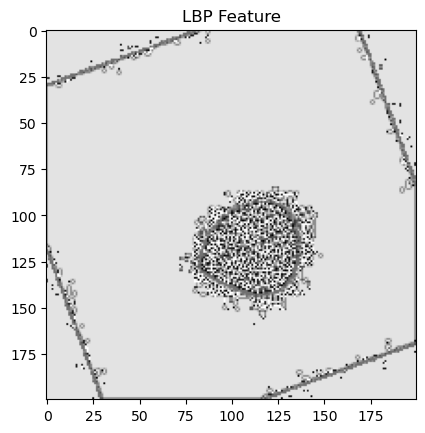

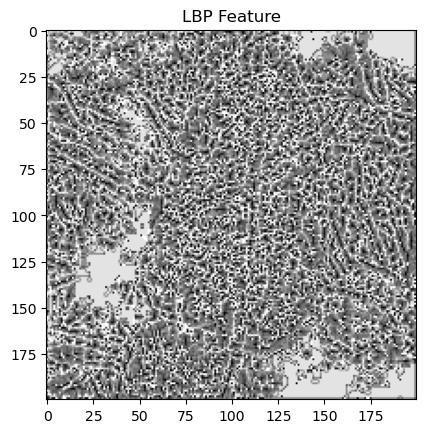

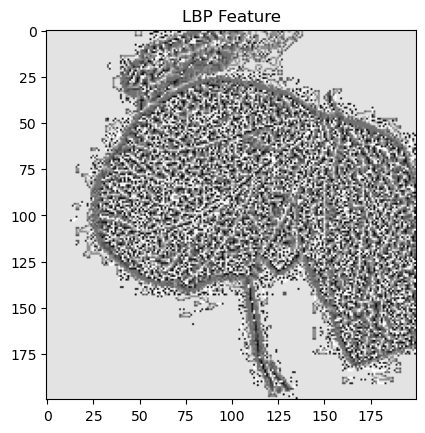

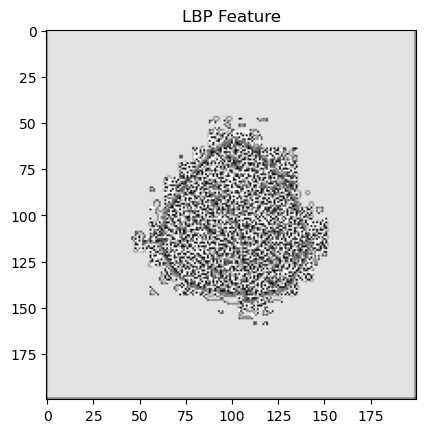

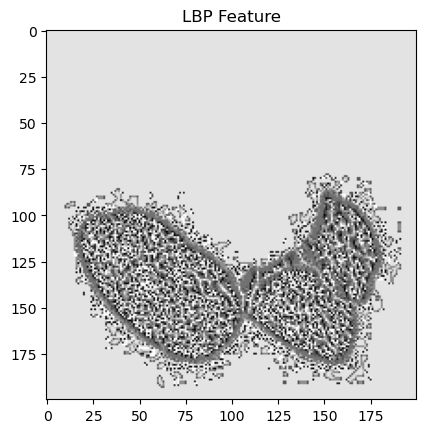

In [38]:
from skimage.exposure import rescale_intensity
import cv2
import matplotlib.pyplot as plt
from skimage.feature import hog
from skimage import exposure
from skimage.feature import graycomatrix, graycoprops
from skimage.feature import local_binary_pattern

def lbp_feature(image):
    lbp = local_binary_pattern(image, P=8, R=1, method='uniform')
    plt.imshow(lbp, cmap='gray')
    plt.title('LBP Feature')
    plt.show()
    return lbp

directory = 'septoria'

folder_path = '/Users/kacperskurski/DataspellProjects/Soybean_Disease_Leaf_Classification/augumentation/' + directory

op_path = '/Users/kacperskurski/DataspellProjects/Soybean_Disease_Leaf_Classification/feature_extraction/' + directory

file_list = os.listdir(folder_path)

image_extensions = ['.jpg', '.jpeg', '.png', '.bmp']
image_files = [file for file in file_list if any(file.lower().endswith(ext) for ext in image_extensions)]

import numpy as np
i = 0
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)
    original_file = cv2.imread(image_path)
    img = cv2.cvtColor(original_file, cv2.COLOR_BGR2GRAY)

    img = lbp_feature(img)
    method = 'lbp'
    save_path = os.path.join(op_path, f"{method}_{os.path.splitext(image_file)[0]}{i}.jpg")

    if not os.path.exists(folder_path):
        os.makedirs(save_path)

    cv2.imwrite(save_path, img)
    i= i+1



In [ ]:
from skimage.exposure import rescale_intensity
import cv2
import matplotlib.pyplot as plt
from skimage.feature import hog
from skimage import exposure
from skimage.feature import graycomatrix, graycoprops
from skimage.feature import local_binary_pattern

def lbp_feature(image):
    lbp = local_binary_pattern(image, P=8, R=1, method='uniform')
    plt.imshow(lbp, cmap='gray')
    plt.title('LBP Feature')
    plt.show()
    return lbp

directory = 'septoria'

folder_path = '/Users/kacperskurski/DataspellProjects/Soybean_Disease_Leaf_Classification/augumentation/' + directory

op_path = '/Users/kacperskurski/DataspellProjects/Soybean_Disease_Leaf_Classification/feature_extraction/' + directory

file_list = os.listdir(folder_path)

image_extensions = ['.jpg', '.jpeg', '.png', '.bmp']
image_files = [file for file in file_list if any(file.lower().endswith(ext) for ext in image_extensions)]

import numpy as np
i = 0
for image_file in image_files:
    image_path = os.path.join(folder_path, image_file)
    original_file = cv2.imread(image_path)
    img = cv2.cvtColor(original_file, cv2.COLOR_BGR2GRAY)

    img = lbp_feature(img)
    method = 'lbp'
    save_path = os.path.join(op_path, f"{method}_{os.path.splitext(image_file)[0]}{i}.jpg")

    if not os.path.exists(folder_path):
        os.makedirs(save_path)

    cv2.imwrite(save_path, img)
    i= i+1

